In [1]:
import tensorflow as tf
import os
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import imgaug.augmenters as iaa
import numpy as np
import albumentations as A
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense,Input,Conv2D,MaxPool2D,Activation,Dropout,Flatten, BatchNormalization, ReLU, Reshape
from tensorflow.keras.models import Model
import random as rn
import glob
import numpy as np
import segmentation_models as sm
from segmentation_models import Unet
from tensorflow.keras.layers import Flatten
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')
sm.set_framework('tf.keras')
tf.keras.backend.set_image_data_format('channels_last')
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

gpu_options = tf.compat.v1.GPUOptions(per_process_gpu_memory_fraction=0.5)
sess = tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(gpu_options=gpu_options))

Using TensorFlow backend.


Segmentation Models: using `keras` framework.


## Pre-processing of image using CV

Coefficient of Variation Formula
Below is the formula for how to calculate the coefficient of variation:

\begin{aligned} &\text{CV} = \frac { \sigma }{ \mu } \\ &\textbf{where:} \\ &\sigma = \text{standard deviation} \\ &\mu = \text{mean} \\ \end{aligned} 
​	
Applying CV for Window size of (3x3) in image, resulting value is placed in centre (1,1).
This process is carried out horizontally as well as vertically. Any artifacts done for image is highlighted by CV processing, whichis helping our model to recognise or localize manipulated region.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


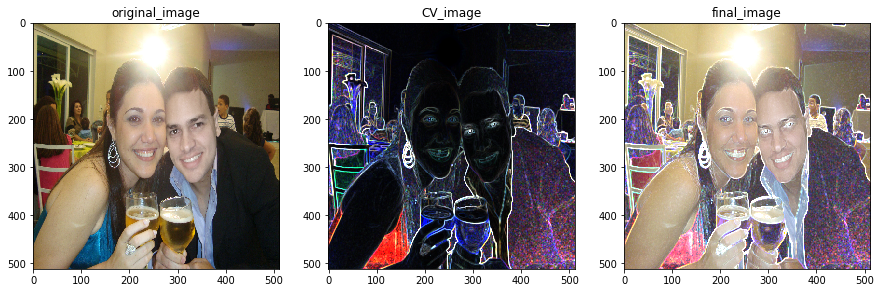

In [2]:
orig = (cv2.imread("fak/010543abfbd0db1e9aa1b24604336e0c.png")[:,:,(2,1,0)])/255.0
orig = cv2.resize(orig,(512,512))
im = np.copy(orig)
for i in range(im.shape[0]-3+1):
    for j in range(im.shape[1]-3+1):
        kernel = orig[i:i+3,j:j+3]            
        mean = np.mean(kernel,axis=(0,1))
        std = np.std(kernel,axis=(0,1))
        im[i+1,j+1] = np.clip((std/mean),0,1)

plt.figure(figsize=(15,6))
plt.subplot(131)
plt.imshow(orig)
plt.title('original_image')
plt.subplot(132)
plt.imshow((2*im))
plt.title('CV_image')
plt.subplot(133)
plt.imshow(orig+(2*im))
plt.title('final_image')
plt.show()

### Data loading

In [3]:
#data loading
imgs = np.sort(glob.glob("testing-1/*"))
mask = np.sort(glob.glob("mask/*"))

#checking if image corresponding to its respective mask
for i in range(imgs.shape[0]):
    if imgs[i].split('/')[-1].split('.')[0] != mask[i].split('/')[-1].split('.')[0]:
        print(imgs[i])

#split into train and test
X_train, X_test, y_train, y_test = train_test_split(imgs, mask, test_size=0.20)
print(len(X_train),len(X_test),len(y_train),len(y_test))

360 90 360 90


#### Data displaying

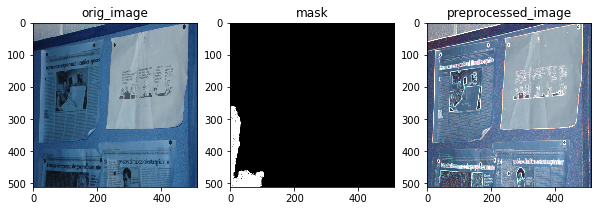

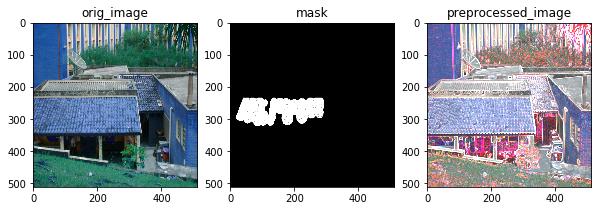

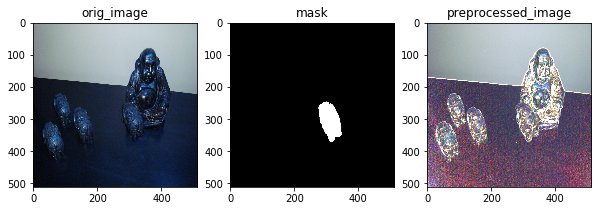

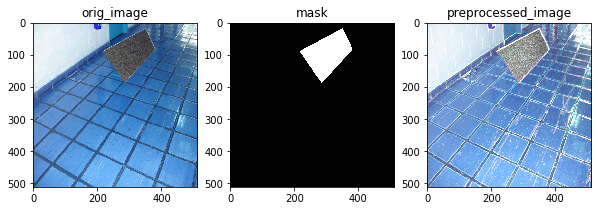

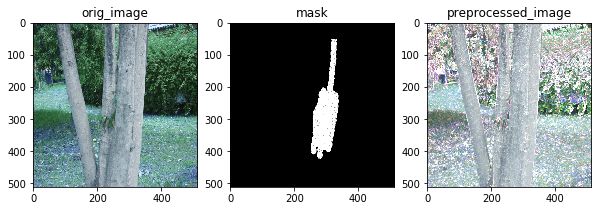

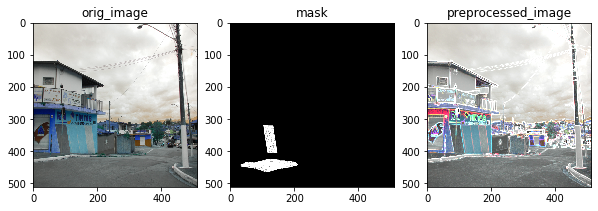

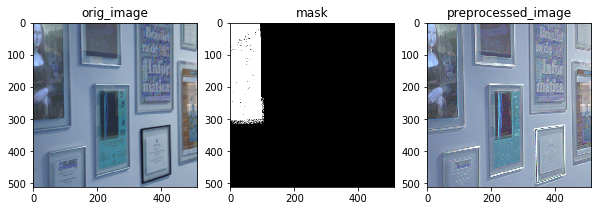

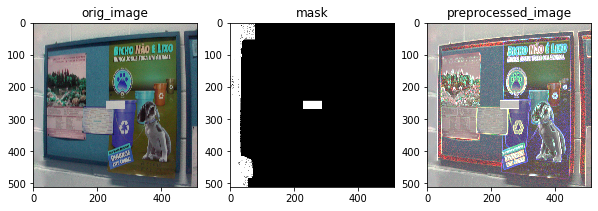

In [4]:
for i in range(40,48):
    image = cv2.imread(X_train[i])[:,:,(2,1,0)]
    image = cv2.resize(image,(512,512))
    orig = cv2.imread("fak/"+X_train[i].split('/')[-1])
    orig = cv2.resize(orig,(512,512))
    mask = cv2.imread(y_train[i])[:,:,(2,1,0)]
    mask = cv2.resize(mask,(512,512))
    plt.figure(figsize=(10,6))
    plt.subplot(131)
    plt.imshow(orig)
    plt.title('orig_image')
    plt.subplot(132)
    plt.imshow((mask))
    plt.title('mask')
    plt.subplot(133)
    plt.imshow((image))
    plt.title('preprocessed_image')
    plt.show()

### Loading U-net model

In [5]:
model = Unet('resnet34', encoder_weights='imagenet', classes=1, activation='sigmoid', input_shape=(512,512,3))

In [6]:
# import imgaug.augmenters as iaa
aug2 = iaa.Fliplr(1)
aug3 = iaa.Flipud(1)
aug4 = iaa.Emboss(alpha=(1), strength=1)
aug5 = iaa.DirectedEdgeDetect(alpha=(0.8), direction=(1.0))
aug6 = iaa.Sharpen(alpha=(1.0), lightness=(1.5))

In [7]:
def normalize_image(mask):
    mask = np.clip(mask/255.0,0,1)
    return mask

class Dataset:
    CLASSES = ['non-edited','edited']
    
    def __init__(
            self, 
            input_paths, 
            output_paths,
            classes=None, 
            augmentation=None, 
            preprocessing=None,):
        
    
        
        self.images_fps = input_paths
        self.masks_fps = output_paths
        
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
        
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
          
        image =cv2.imread(self.images_fps[i], cv2.IMREAD_UNCHANGED)
        mas = cv2.imread(self.masks_fps[i], cv2.IMREAD_UNCHANGED)
        image = cv2.resize(image,(512,512))[:,:,(2,1,0)]
        mas = cv2.resize(mas,(512,512))
        image_mask = normalize_image(mas)
        image = normalize_image(image)
        
        image_masks = [(image_mask == v) for v in self.class_values]
        image_mask = np.stack(image_masks, axis=-1).astype('float')
   
        a = np.random.uniform()
        if a<0.2:
            image = aug2.augment_image(image)
            image_mask = aug2.augment_image(image_mask)
        elif a<0.4:
            image = aug3.augment_image(image)
            image_mask = aug3.augment_image(image_mask)
        elif a<0.6:
            image = aug4.augment_image(image)
            image_mask = aug4.augment_image(image_mask)
        elif a<0.8:
            image = aug5.augment_image(image)
            image_mask = image_mask
        else:
            image = aug6.augment_image(image)
            image_mask = aug6.augment_image(image_mask)
        
        
        return image, image_mask
        
    def __len__(self):
        return len(self.images_fps)
    
    
class Dataloder(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

        self.on_epoch_end()

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [8]:
# define optomizer
optim = tf.keras.optimizers.Adam(0.0001)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, total_loss, metrics)

In [9]:
BACKBONE = 'efficientnetb3'
BATCH_SIZE = 8
preprocess_input = sm.get_preprocessing(BACKBONE)

In [10]:
# Dataset for train images
CLASSES = ['edited']
dir_path = ""
train_dataset = Dataset(X_train,y_train, classes=CLASSES)
test_dataset  = Dataset(X_test,y_test, classes=CLASSES)


train_dataloader = Dataloder(train_dataset, batch_size=8, shuffle=True)
test_dataloader = Dataloder(test_dataset, batch_size=8, shuffle=True)

print(train_dataloader[0][0].shape,train_dataloader[0][1].shape)
assert train_dataloader[0][0].shape == (BATCH_SIZE, 512, 512, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 512, 512, 1)

(8, 512, 512, 3) (8, 512, 512, 1)


In [11]:
#takes lot of time to train, so loading model from saved weights.
model.load_weights('test_seg.h5')

In [12]:
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint

filepath="final_seg.h5"
checkpoint = ModelCheckpoint(filepath, monitor='val_iou_score', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]

history = model.fit_generator(train_dataloader, steps_per_epoch=len(train_dataloader), epochs=5,
                              validation_data=test_dataloader,validation_steps=len(test_dataloader),callbacks=callbacks_list)

Epoch 1/5
44/45 [============================>.] - ETA: 0s - loss: 0.2244 - iou_score: 0.6627 - f1-score: 0.7686
Epoch 00001: val_iou_score improved from -inf to 0.72603, saving model to final_seg.h5
45/45 [==============================] - 55s 1s/step - loss: 0.2238 - iou_score: 0.6626 - f1-score: 0.7692 - val_loss: 0.1379 - val_iou_score: 0.7260 - val_f1-score: 0.8141
Epoch 2/5
44/45 [============================>.] - ETA: 0s - loss: 0.1855 - iou_score: 0.6847 - f1-score: 0.7900
Epoch 00002: val_iou_score did not improve from 0.72603
45/45 [==============================] - 41s 912ms/step - loss: 0.1875 - iou_score: 0.6854 - f1-score: 0.7911 - val_loss: 0.2798 - val_iou_score: 0.5869 - val_f1-score: 0.7252
Epoch 3/5
44/45 [============================>.] - ETA: 0s - loss: 0.1669 - iou_score: 0.6988 - f1-score: 0.8013
Epoch 00003: val_iou_score did not improve from 0.72603
45/45 [==============================] - 42s 931ms/step - loss: 0.1677 - iou_score: 0.6977 - f1-score: 0.8010 - v

In [13]:
model.load_weights('final_seg.h5')

### Results on test data

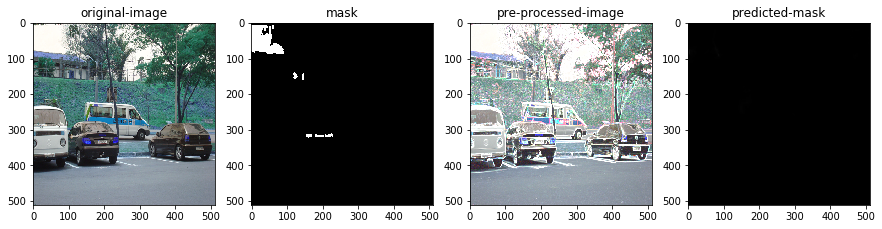

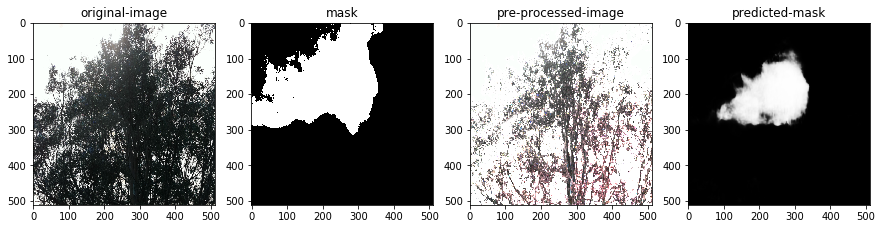

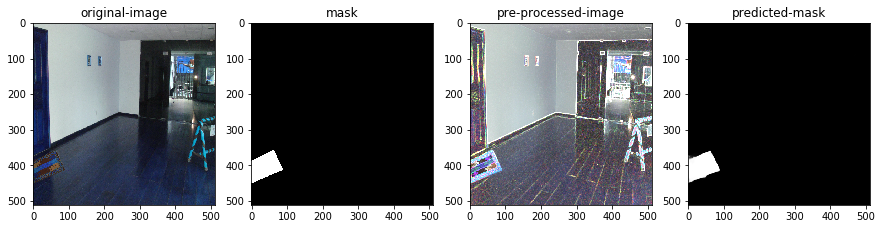

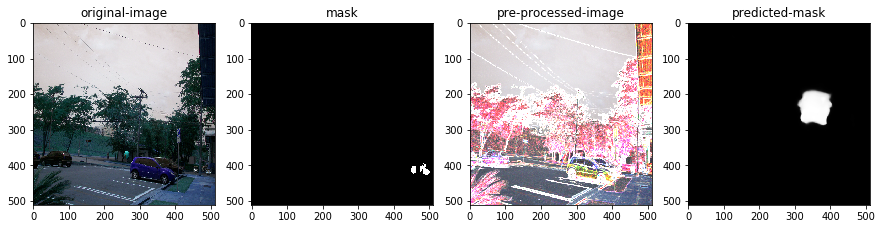

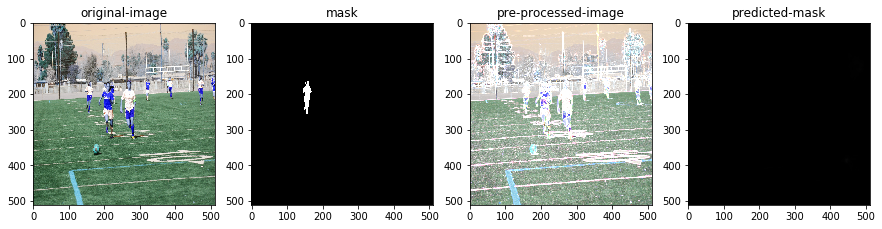

...

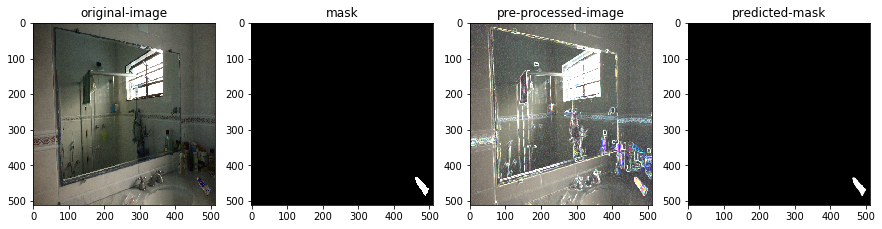

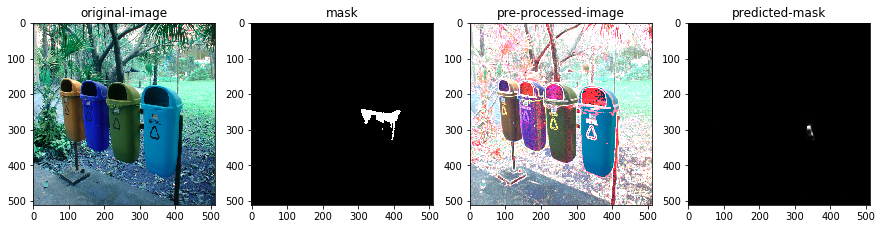

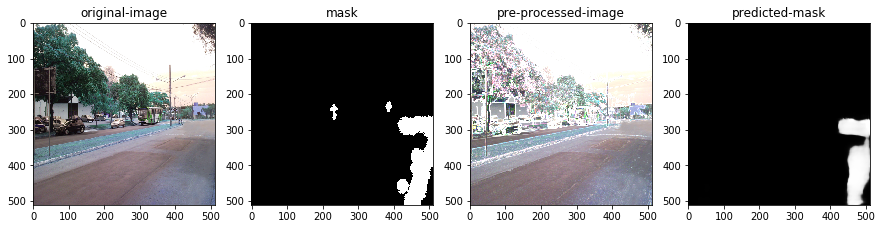

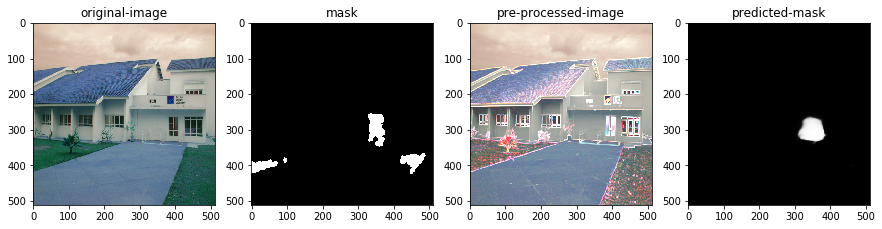

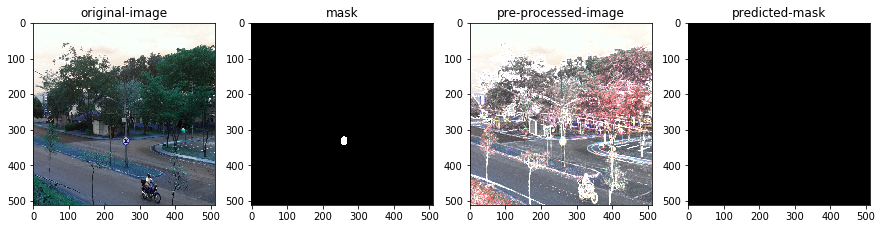

In [14]:
for each in zip(X_test[:40],y_test[:40]):
    image=cv2.imread(each[0], cv2.IMREAD_UNCHANGED)[:,:,(2,1,0)]/255.0
    image = cv2.resize(image, (512,512))
    orig = cv2.imread("fak/"+each[0].split('/')[-1])
    orig = cv2.resize(orig,(512,512))
    predicted = model.predict(image[np.newaxis,:,:,:])
    image_mask=cv2.imread(each[1], cv2.IMREAD_UNCHANGED)
    image_mask = cv2.resize(image_mask, (512,512))
    plt.figure(figsize=(15,6))
    plt.subplot(141)
    plt.imshow(orig)
    plt.title('original-image')
    plt.subplot(142)
    plt.imshow(image_mask, cmap='gray', vmax=1, vmin=0)
    plt.title('mask')
    plt.subplot(143)
    plt.imshow(image)
    plt.title('pre-processed-image')
    plt.subplot(144)
    plt.imshow(predicted[0,:,:,0], cmap='gray', vmax=1, vmin=0)
    plt.title('predicted-mask')
    plt.show()

### Results on train data

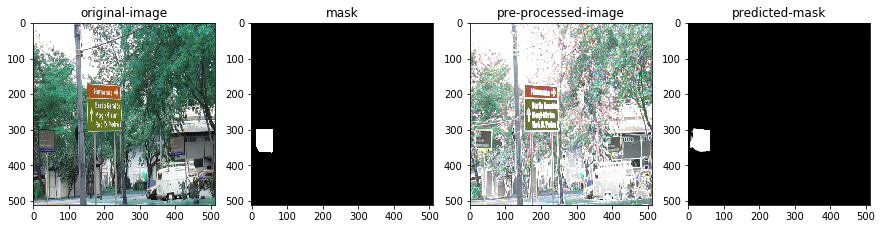

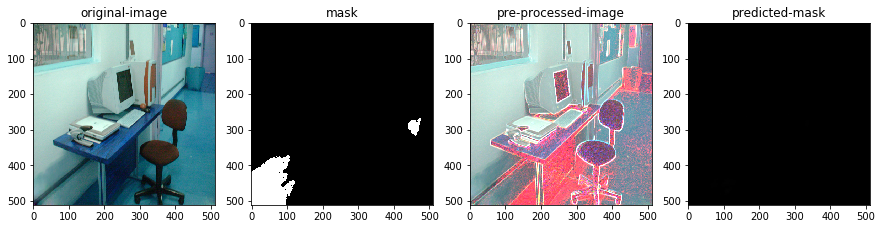

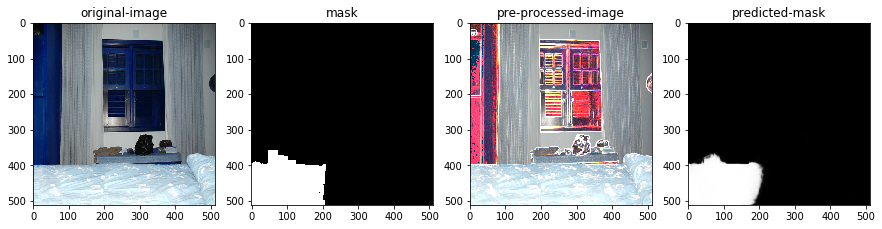

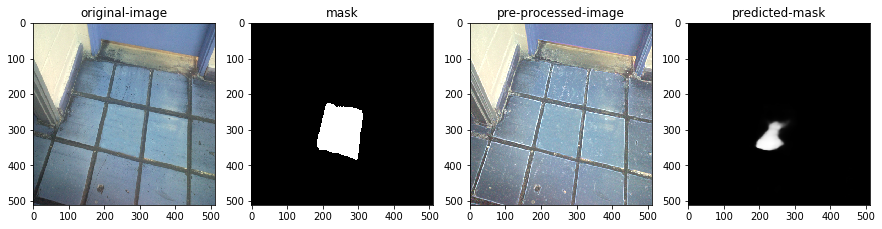

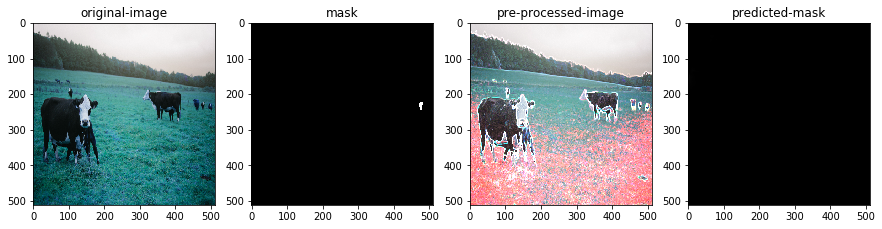

...

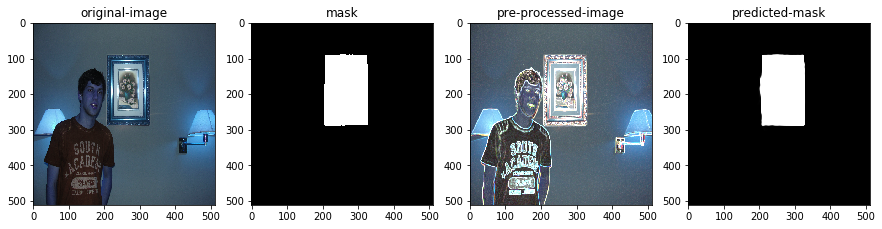

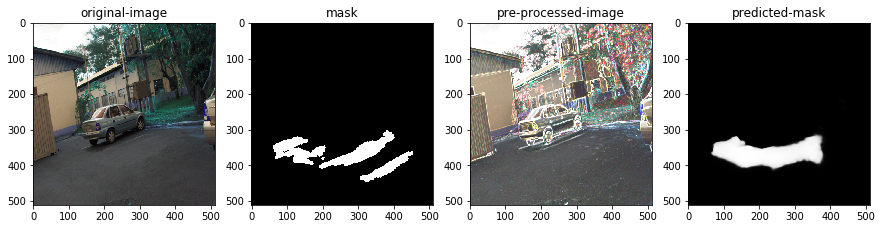

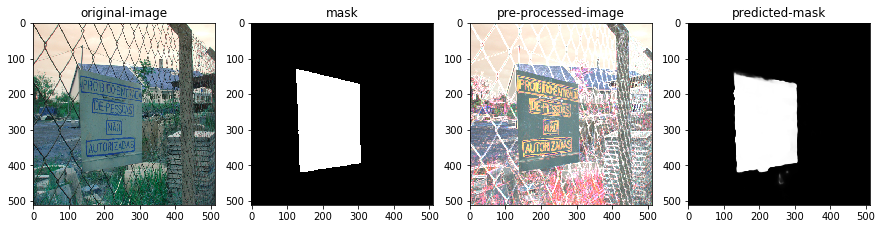

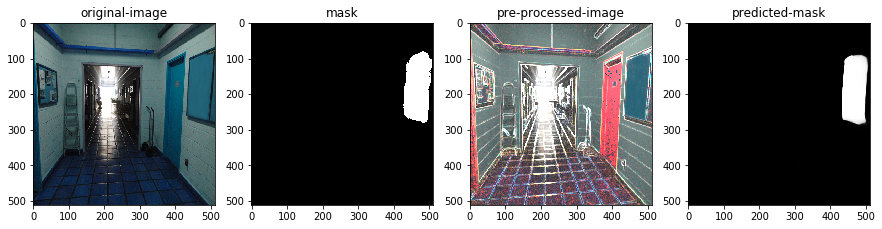

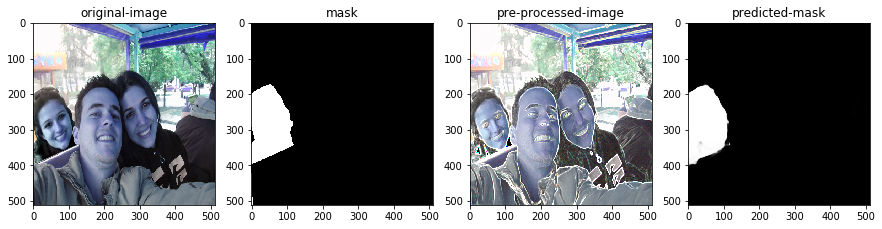

In [15]:
for each in zip(X_train[50:90],y_train[50:90]):
    image=cv2.imread(each[0], cv2.IMREAD_UNCHANGED)[:,:,(2,1,0)]/255.0
    image = cv2.resize(image, (512,512))
    orig = cv2.imread("fak/"+each[0].split('/')[-1])
    orig = cv2.resize(orig,(512,512))
    predicted = model.predict(image[np.newaxis,:,:,:])
    image_mask=cv2.imread(each[1], cv2.IMREAD_UNCHANGED)
    image_mask = cv2.resize(image_mask, (512,512))
    plt.figure(figsize=(15,6))
    plt.subplot(141)
    plt.imshow(orig)
    plt.title('original-image')
    plt.subplot(142)
    plt.imshow(image_mask, cmap='gray', vmax=1, vmin=0)
    plt.title('mask')
    plt.subplot(143)
    plt.imshow(image)
    plt.title('pre-processed-image')
    plt.subplot(144)
    plt.imshow(predicted[0,:,:,0], cmap='gray', vmax=1, vmin=0)
    plt.title('predicted-mask')
    plt.show()